<h1><center>Vaccination Drives and the Inequalities Underneath</center></h1>
<h4><center>
<a style="text-decoration:none" href="https://github.com/eshan-rg">Eshan Gujarathi</a>, IIT Gandhinagar, <a style="text-decoration:none" href="mailto:<author1>@iitgn.ac.in">eshan.rg@iitgn.ac.in</a>
<br><br>
<a style="text-decoration:none" href="https://github.com/HitarthGandhi">Hitarth Gandhi</a>, IIT Gandhinagar, <a style="text-decoration:none" href="mailto:<author2>@iitgn.ac.in">hitarth.g@iitgn.ac.in</a>
<br><br>
<a style="text-decoration:none" href="https://github.com/Vishal1309">Vishal Soni</a>, IIT Gandhinagar, <a style="text-decoration:none" href="mailto:<author3>@iitgn.ac.in">jayesh.s@iitgn.ac.in</a>
</center></h4>

<center><a href="https://github.com/CS328-Spring-2022/writing-assignment-vishal_eshan_hitarth"><img src="https://img.shields.io/badge/Github-Writing%20Assignment-brightgreen" alt="Repo"></a></center>

# Covid Vaccination Drive Analysis and the Inequalities Underneath

### Introduction

Covid-19 pandemic, something we are much aware of today, has had a devastating impact on the world in the recent years. It is much more than a health threat and has affected each individual in some way or the other.

### Analysis of the Covid Spread around the world

In [1]:
# Importing the libraries needed
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from ipywidgets import widgets, interactive
import plotly.io as pio
import plotly.express as px
pio.renderers.default='notebook'

In [2]:
# Reading the data
covid_df = pd.read_csv("./data/owid-covid-data.csv.gz", compression="gzip")

In [3]:
required_columns = ["iso_code", "location", "continent", "date", "new_cases_smoothed", "total_cases"]
covid_df = covid_df.dropna(subset = required_columns)
# covid_df_sub = covid_df.sort_values("date")

In [4]:
covid_day_df = covid_df[covid_df.date == "2020-06-23"]
covid_day_df.sample(5)

,Unnamed: 0,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,...,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
142391,142391,SDN,Africa,Sudan,2020-06-23,8796.0,98.0,194.429,548.0,15.0,...,NaN,NaN,23.437,0.8,65.31,0.510,NaN,NaN,NaN,NaN
129052,129052,SMR,Europe,San Marino,2020-06-23,713.0,0.0,2.571,42.0,0.0,...,NaN,NaN,NaN,3.8,84.97,NaN,NaN,NaN,NaN,NaN
80704,80704,OWID_KOS,Europe,Kosovo,2020-06-23,2216.0,47.0,85.857,37.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
65226,65226,HTI,North America,Haiti,2020-06-23,5211.0,134.0,128.857,88.0,0.0,...,2.9,23.1,22.863,0.7,64.00,0.510,NaN,NaN,NaN,NaN
43535,43535,ECU,South America,Ecuador,2020-06-23,51643.0,1003.0,528.571,4274.0,51.0,...,2.0,12.3,80.635,1.5,77.01,0.759,NaN,NaN,NaN,NaN


In [5]:
fig = px.scatter_geo(covid_day_df, locations="iso_code", color="continent",
                     hover_name="location", size="new_cases_smoothed",
                     projection="natural earth", template="seaborn")

fig.show()

In [6]:
fig = px.scatter_geo(covid_df, locations="iso_code", color="continent",
                     hover_name="location", size="total_cases",
                     projection="natural earth", animation_frame="date", template="seaborn")

fig.show()

### Covid Vaccinations by different manufacturers

Now let us have a look at how there was a rise in the number of doses of different vaccines in various countries. The type of vaccine and thus the manufacturer played an important role in the vaccination drives due to their cost and success rate.

First we import the data. The data contains the number of total doses of different vaccines with time in each country.

In [7]:
# Importing the data
v_by_manu = pd.read_csv("./data/vaccinations/vaccinations-by-manufacturer.csv")
v_by_manu.head()

,location,date,vaccine,total_vaccinations
0,Argentina,2020-12-29,Moderna,2
1,Argentina,2020-12-29,Oxford/AstraZeneca,5
2,Argentina,2020-12-29,Sinopharm/Beijing,1
3,Argentina,2020-12-29,Sputnik V,20481
4,Argentina,2020-12-30,Moderna,2


Following is the plot for the country Argentina. The x-axis represents the time series and the y-axis contains the number of total doses of that particular vaccine. We can observe how certain vaccines saw a sudden rise in their production.

Text(0.5, 1.0, 'Argentina')

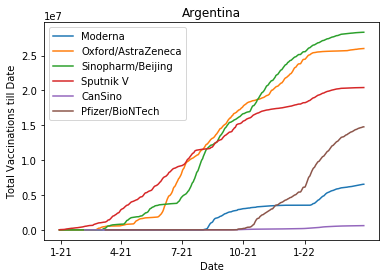

In [8]:
j="Argentina"
v_arg=v_by_manu[v_by_manu["location"]==j]
for i in v_arg["vaccine"].unique():
    v_arg_spu=v_arg[v_arg["vaccine"]==i]
    plt.plot(v_arg_spu["date"],v_arg_spu["total_vaccinations"], label=i)
x_ticks = ["2021-01-01", "2021-04-01", "2021-07-01", "2021-10-01", "2022-01-01"]
x_labels = ['1-21', '4-21', '7-21', '10-21', '1-22'] 
plt.xticks(ticks=x_ticks, labels=x_labels)
plt.legend()
plt.xlabel('Date')
plt.ylabel('Total Vaccinations till Date')
plt.title(j)

We can also create a interactive plot in the following way. When run in python, this gives us a dropdown to select the country for which we need to analyse the number of doses of different vaccines used in that country.

In [9]:
area = widgets.Dropdown(
    options=v_by_manu["location"].unique(),
    value='Argentina',
    description='Country',
)

def plotit(area):
    v_arg=v_by_manu[v_by_manu["location"]==area]
    x_ticks = [v_arg["date"].min(),v_arg["date"].max()]
    for i in v_arg["vaccine"].unique():
        v_arg_spu=v_arg[v_arg["vaccine"]==i]
        plt.plot(v_arg_spu["date"],v_arg_spu["total_vaccinations"], label=i)
    x_labels = x_ticks
    plt.xticks(ticks=x_ticks, labels=x_labels)
    plt.legend()
    plt.xlabel('Date')
    plt.ylabel('Total Vaccinations till Date')
    plt.title(area)

In [10]:
interactive(plotit, area=area)

interactive(children=(Dropdown(description='Country', options=('Argentina', 'Austria', 'Belgium', 'Bulgaria', …

### Covid Vaccination

In [11]:
vaccinations = pd.read_csv("data/vaccinations/vaccinations.csv")
vaccinations.head()

,location,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,total_boosters_per_hundred,daily_vaccinations_per_million,daily_people_vaccinated,daily_people_vaccinated_per_hundred
0,Afghanistan,AFG,2021-02-22,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN
1,Afghanistan,AFG,2021-02-23,NaN,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,NaN,34.0,1367.0,0.003
2,Afghanistan,AFG,2021-02-24,NaN,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,NaN,34.0,1367.0,0.003
3,Afghanistan,AFG,2021-02-25,NaN,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,NaN,34.0,1367.0,0.003
4,Afghanistan,AFG,2021-02-26,NaN,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,NaN,34.0,1367.0,0.003


In [12]:
cols = ['location', 'iso_code', 'total_vaccinations']
vaccinations.dropna(subset=cols, inplace=True)

In [13]:
fig = px.scatter_geo(vaccinations, locations="iso_code", color="location",
                     hover_name="location", size="total_vaccinations",
                     projection="natural earth", animation_frame="date", template="seaborn")

fig.show()